In [1]:
import pandas as pd
import pickle as pkl
df_lemma = pd.read_pickle("..\\datasets\\tweets_cleaned_lemma_stopwords.pkl.gz")

In [2]:
tweets_lemma = df_lemma.tweet.to_list()

In [3]:
df_normal = pd.read_pickle("..\\datasets\\tweets_cleaned.pkl.gz")

In [4]:
tweets_normal = df_normal.tweet.to_list()

In [5]:
x = pd.DataFrame(zip(tweets_normal, tweets_lemma))
x

,0,1
0,Środki finansowe z UE są nam bardzo potrzebne....,środek ue przykład fundusz dzień personel pacj...
1,Konferencja prasowa z udziałem Parlamentarzyst...,konferencja udział parlamentarzysta koalicjaob...
2,Pytanie o dostępność szczepionek przeciwko grypie,pytanie dostępność szczepionka grypa
3,Walka z COVID-19,walka covid
4,Czekam na pytania,pytanie
...,...,...
1490901,No właśnie.,
1490902,Bardzo dobre informacje dl całej Południowej W...,informacja wielkopolska ostrów kalisz szczegó...
1490903,"Inwestycja LPR niezwykle potrzebna i ważna, dl...",inwestycja lpr ostrów ostrowian region
1490904,"Drodzy Państwo, dziś mija dokładnie 25 lat od ...",państwo rok


In [6]:
with open("vectorizer_4000.pkl.gz", "rb") as f:
    vectorizer = pkl.load(f)

with open("lda_15.pkl.gz", "rb") as f:
    lda = pkl.load(f)


In [7]:
import numpy as np
top_words_indices = np.argsort(lda.components_)[:, ::-1]
top_words = np.array(vectorizer.get_feature_names())[top_words_indices]
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_columns', None)
pd.DataFrame(top_words[:, :30])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
0,sprawa,zdrowie,sytuacja,informacja,głos,służba,zdanie,pomysł,wywiad,szpital,serce,wyborca,koronawirus,ochrona,lekarz,bezpieczeństwo,dana,materiał,artykuł,reakcja,pracownik,emerytura,źródło,internet,dokument,news,temat,autor,dostęp,życie
1,pis,rząd,ue,państwo,polska,budżet,kraj,unia,redaktor,cel,działanie,firma,system,granica,gospodarka,środek,podatek,polak,polityka,cena,zasada,kryzys,koszt,pieniądz,interes,przedsiębiorca,rozwiązanie,euro,władza,rynek
2,spotkanie,kampania,mieszkaniec,kandydat,lewica,akcja,poparcie,odpowiedź,dziennikarz,lista,prokuratura,opinia,powiat,podpis,biuro,lublin,noc,policja,konferencja,rozmowa,koalicjaobywatelska,poziom,pytanie,inicjatywa,okręg,komitet,region,sobota,województwo,nazwisko
3,decyzja,brawo,wniosek,uwaga,zmiana,tydzień,zgoda,racja,psl,sld,ofiara,głosowanie,stan,koalicja,pis,raport,ruch,pozdrowienie,sprawa,bóg,wrażenie,po,katastrofa,miesiąc,wypadek,ekspert,samolot,badanie,zwycięstwo,kukiz
4,sejm,poseł,po,komisja,pis,partia,opozycja,marszałek,posiedzenie,senat,tusk,szef,sprawa,członek,sala,platforma,poznań,senator,rp,rada,kadencja,film,głosowanie,afera,przewodniczący,obrady,klub,krok,zespół,minuta
5,wybory,praca,miejsce,miasto,nikt,rada,wynik,niedziela,kolega,gdańsk,powód,wpis,wiadomość,przykład,maj,brak,głos,wrocław,radny,wiedza,list,zaufanie,atak,urząd,mieszkaniec,doświadczenie,deklaracja,wiec,wieś,proces
6,osoba,koniec,świat,ręka,przypadek,kościół,początek,błąd,mecz,góra,głowa,liczba,oko,historia,różnica,weekend,szczęście,emocja,pogląd,lgbt,aborcja,ksiądz,miłość,mistrz,czoło,suma,ojciec,kara,wzgląd,finał
7,polska,polityka,europa,droga,medium,usa,rosja,ukraina,współpraca,niemcy,środowisko,kultura,obrona,wizyta,rozwój,relacja,nato,kraj,teza,putin,szczyt,francja,trzaskowski2020,rola,nauka,wiek,trump,mon,ambasador,msz
8,strona,debata,program,rozmowa,chwila,pe,udział,gratulacja,dyskusja,gość,święto,parlament,godzina,sukces,radio,temat,przyszłość,konwencja,trzaskowski,bruksela,argument,tv,rafał,profesor,rzeczywistość,oglądać,tvn,moc,telewizja,woda
9,raz,dziecko,rodzina,szkoła,dom,pomoc,komentarz,samorząd,budowa,program,umowa,wieczór,wsparcie,inwestycja,rodzic,książka,propozycja,gmina,młodzież,ogół,senior,efekt,centrum,wojsko,potrzeba,zadanie,zakup,mieszkanie,samochód,znak


In [8]:
def predict(lda, vectorizer, texts):
    counts = vectorizer.transform(texts)
    probas = lda.transform(counts)
    labels = np.argmax(probas, axis=1)
    return labels

def predict_probas(lda, vectorizer, texts):
    counts = vectorizer.transform(texts)
    probas = lda.transform(counts)
    return probas

def show_most_probable_k_tweets_from_each_class(probas, texts, k=10):
#     labels = np.argmax(probas, axis=1)
#     unique, counts = np.unique(text_labels, return_counts=True)
#     percentages = counts / np.sum(counts)
#     print(pd.DataFrame(zip(unique, percentages)))
    most_probable_text_per_class_indices = probas.argsort(axis=0)[::-1, :]
    k_most_probable_text_indices = most_probable_text_per_class_indices[:k]
    k_most_probable_texts = np.array(texts)[k_most_probable_text_indices]
    
    for label in range(probas.shape[1]):
        
        print(f"-----------EXAMPLE TEXTS FOR TOPIC {label}--------")
        topic_texts = k_most_probable_texts[:, label]
        print(topic_texts)
        print()
#         topic_texts = np.array(texts)[text_labels==label]
#         k_texts = np.random.choice(topic_texts, k, replace=False)
#         for t in k_texts:
#             print(t)

In [9]:
labels = predict(lda, vectorizer, tweets_lemma)

In [10]:
probas = predict_probas(lda, vectorizer, tweets_lemma)

In [11]:
show_most_probable_k_tweets_from_each_class(probas, tweets_normal, 15)

-----------EXAMPLE TEXTS FOR TOPIC 0--------
['Gdzie są środki ochrony osobistej i testy dla personelu medycznego? Zakażeni pacjenci mogą być na każdym oddziale. Z zapaleniem płuc ➡️ obowiązkowy test❗️W stanie epidemii zabezpieczenie jednoimiennych szpitali zakaźnych niewystarczające❗️ '
 '❗Nie okłamuj Ratownika, Lekarza ❗Przed każdą interwencją medyczną rzetelnie poinformuj przyjmującego zgłoszenie operatora o swoim stanie zdrowia czy jesteś objęty kwarantanną o kontakcie z chorym na koronowirusa. Nie informując o tym możesz narazić Ratowników❗ '
 'Szpital Narodowy musi zacząć pomagać ciężej chorym pacjentom z COVID-19 - żądają dyrektorzy mazowieckich szpitali. Nie może być tak, że pacjenci z COVID19 leżą na szpitalnych SOR-ach, przez co blokowane są przyjęcia kolejnych chorych. '
 ' Za służbę w WOP i SG również. Oraz za służbę w Policji, ABW, AW, SKW, SWW, CBA, BOR, Państwowej Straży Pożarnej i Służbie Więziennej. Odebrano też zasiłki wdowom i sierotom.'
 'Dostęp do testów dla pracow


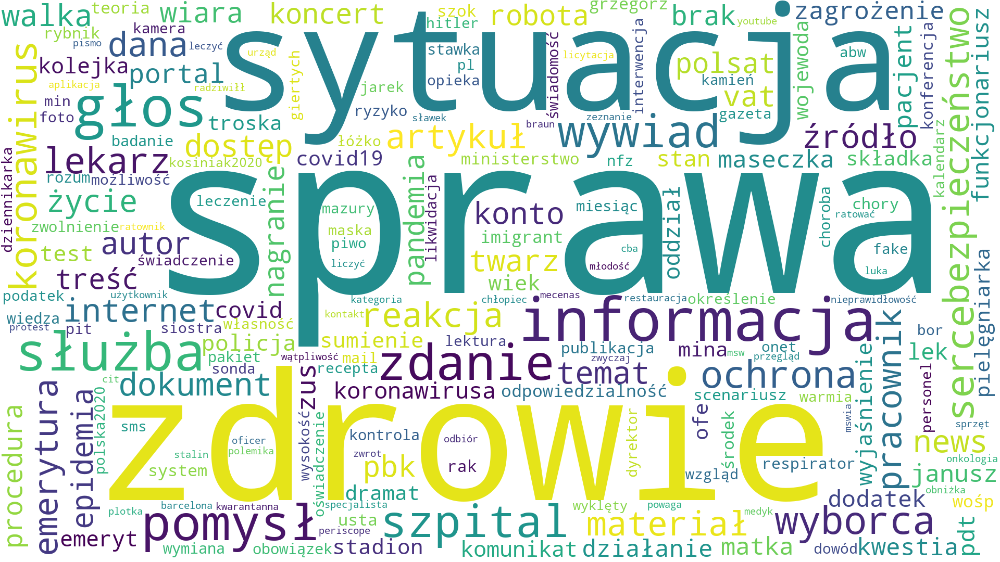


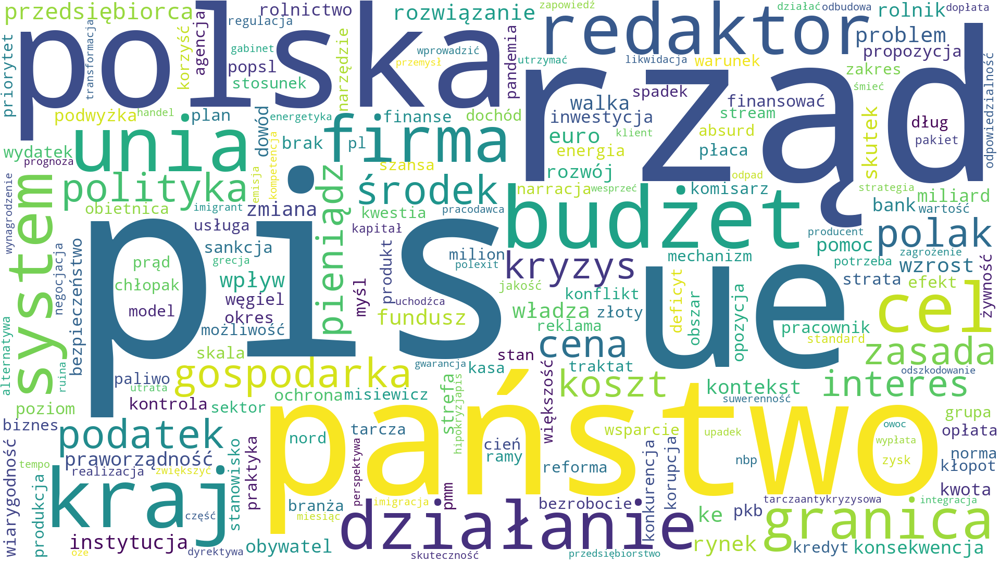


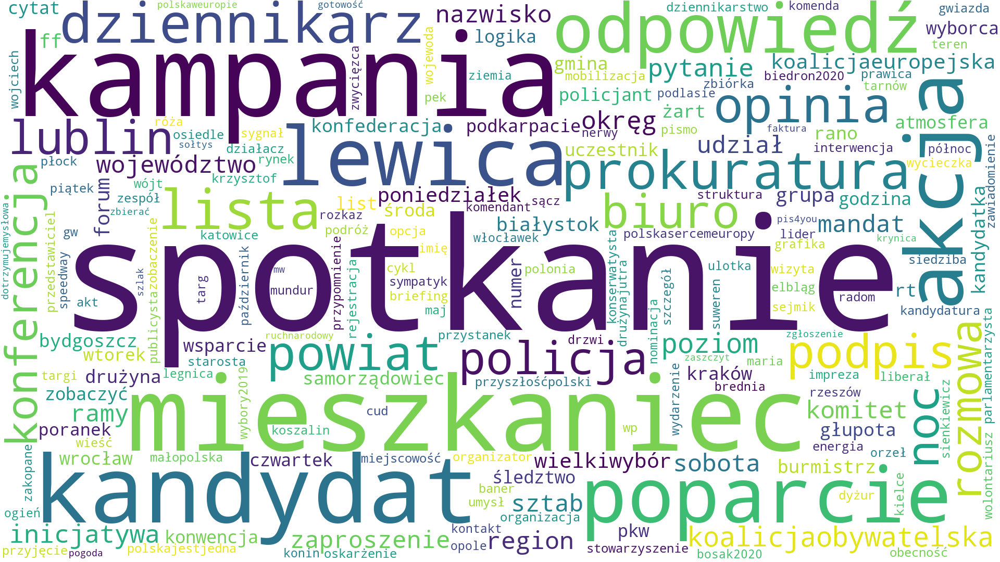


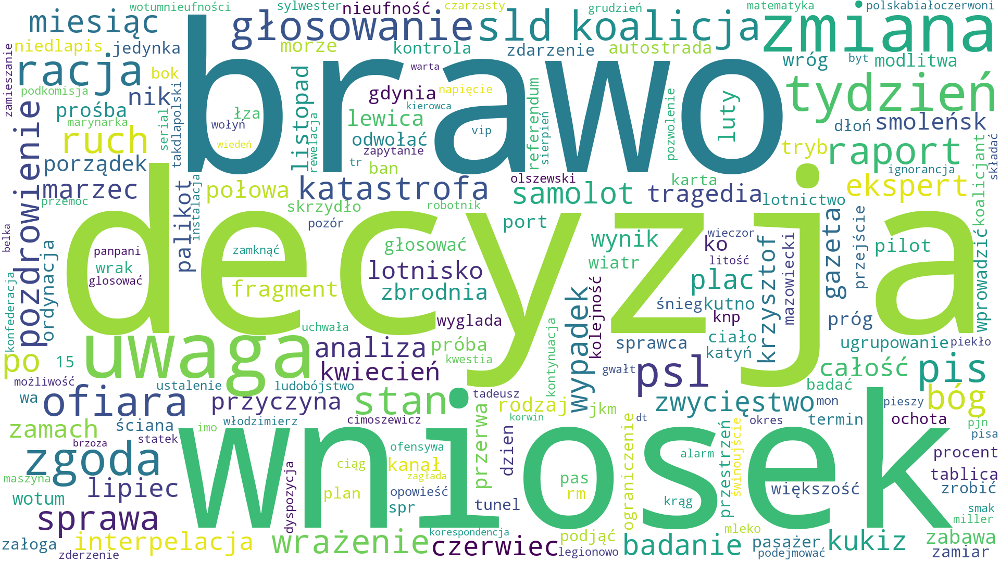


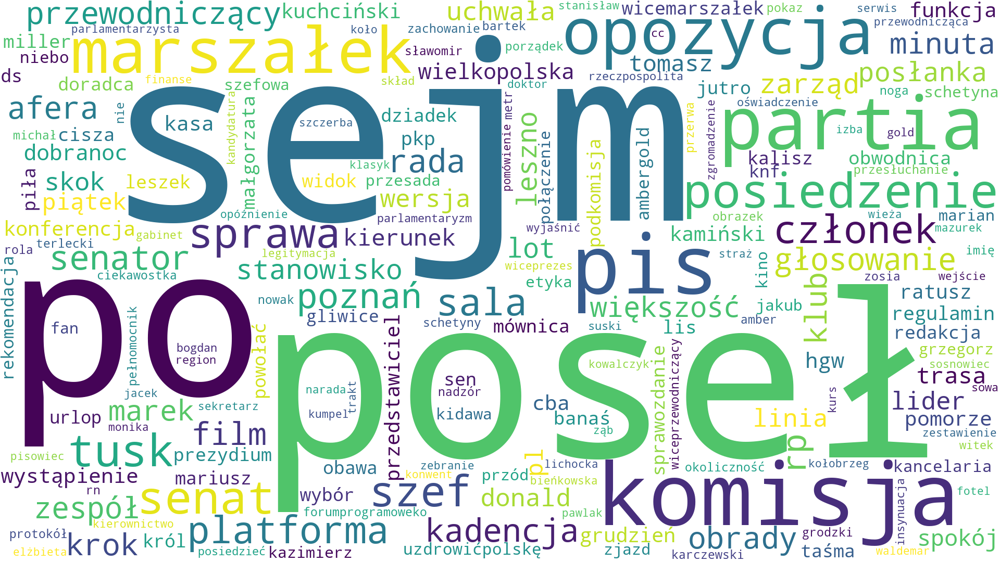


...


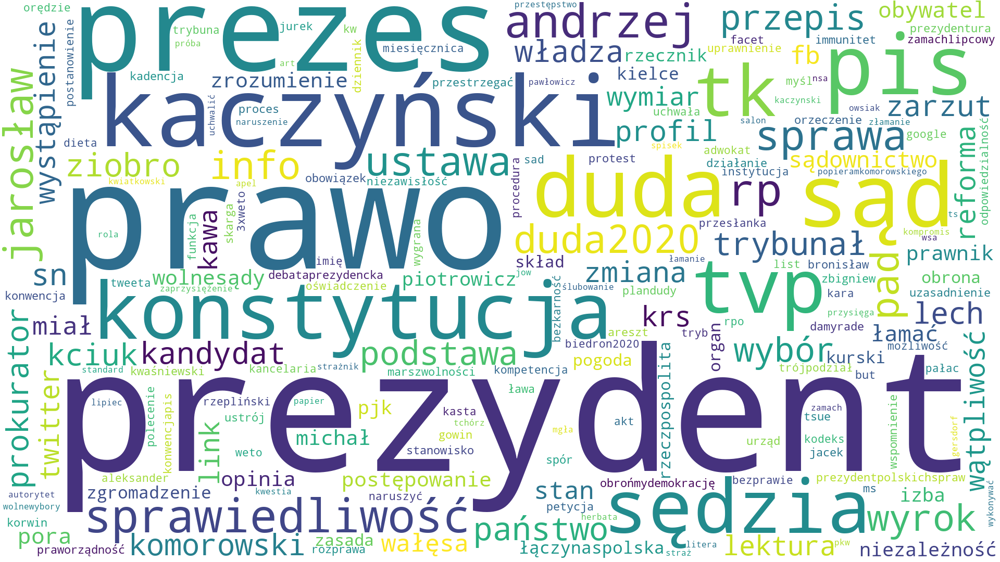


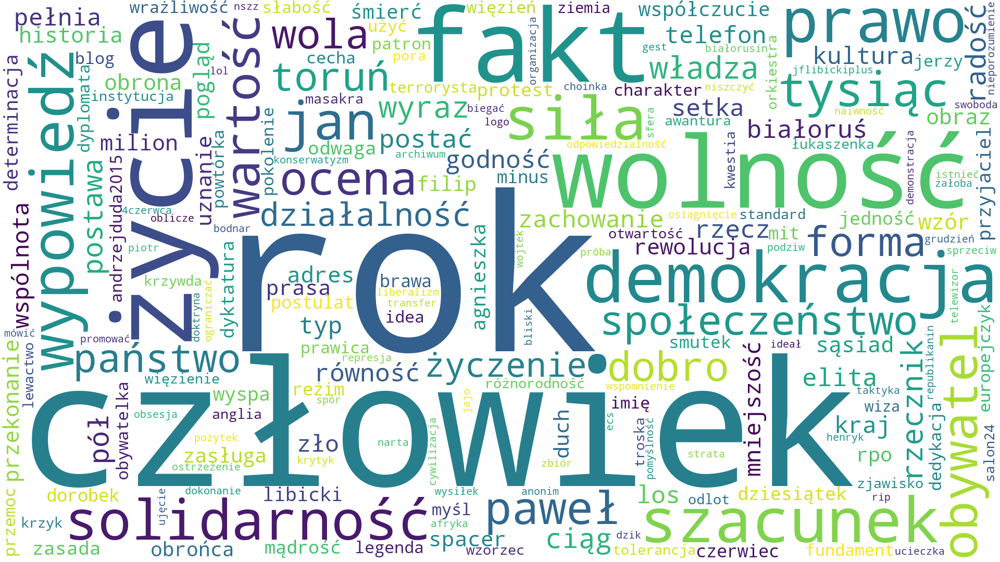


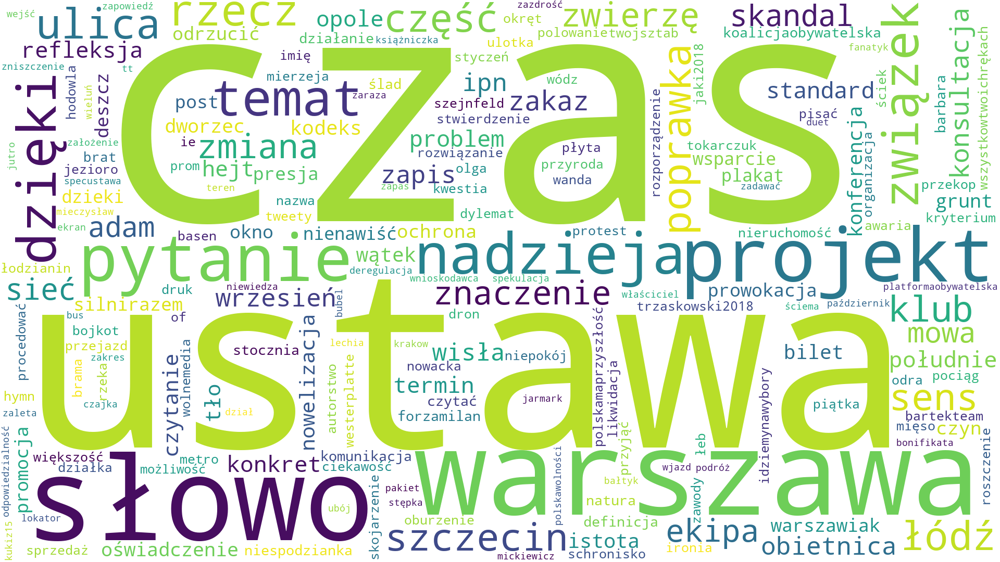


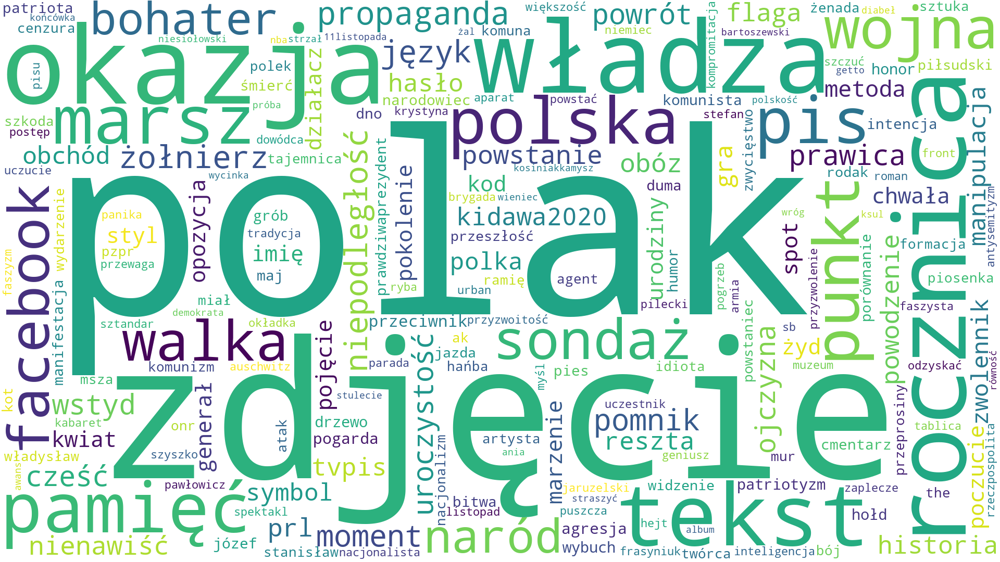


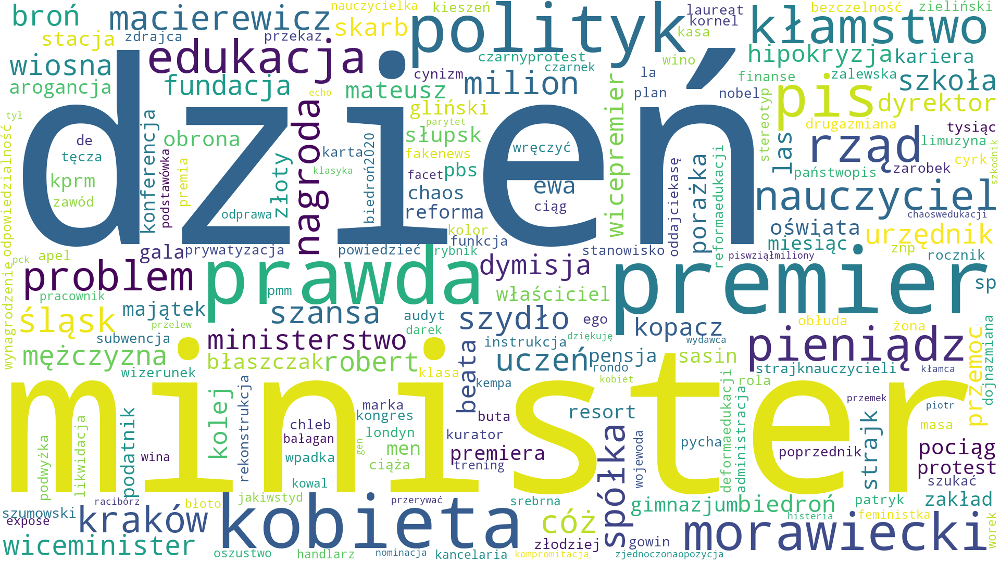

In [21]:
from wordcloud import WordCloud
import plotly.express as px
import matplotlib.pyplot as plt


for i in range(len(lda.components_)):
    topic = lda.components_[i]
    frequencies = {name: freq for name, freq in zip(vectorizer.get_feature_names(), topic)}
    wordcloud = WordCloud(
        width=1920, height=1080, background_color="white"
    ).generate_from_frequencies(frequencies=frequencies)
    fig = px.imshow(wordcloud, title=f"Topic {i}")
    fig.show()

In [80]:
a = df_normal.reset_index()
users = df_normal['username'].unique()

def get_topic_distribution_for_column(column_value, column_name):
    indices = np.array(a[a[column_name]==column_value].index.tolist())
    topics = probas[indices]
    values = np.sum(topics, axis=0)
    distribution = values / np.sum(values)
    return distribution

def get_topic_distribution_for_user(username):
#     indices = np.array(a[a.username==username].index.tolist())
#     topics = probas[indices]
#     values = np.sum(topics, axis=0)
#     distribution = values / np.sum(values)
#     return distribution
    return get_topic_distribution_for_column(username, "username")


In [81]:
topics_for_users = np.stack([get_topic_distribution_for_user(u) for u in users])

In [82]:
def plot_user_topic_distribution(username):
    user_topics = topics_for_users[users == username].squeeze()
    fig = px.bar(user_topics, title=f'Topic distribution for {username}')
    fig.update_xaxes(type='category')
    fig.show()
plot_user_topic_distribution("krzysztofbosak")
plot_user_topic_distribution("bbudka")

In [64]:
most_accusing_users = np.argsort(topics_for_users[:, 14])[::-1]
most_accusing = most_accusing_users[0]
most_accusing

255

In [77]:
plot_user_topic_distribution(users[most_accusing_users[0]])
plot_user_topic_distribution(users[most_accusing_users[1]])
plot_user_topic_distribution(users[most_accusing_users[2]])

In [69]:
def show_users_k_tweets_most_from_topic_t(user, k, topic):
    tweet_indices = a[a.username==user].index.tolist()
    tweet_probas = probas[tweet_indices][:, topic]
    most_belonging_to_topic = np.argsort(tweet_probas)[::-1]
    most_belonging_tweet_indices = np.array(tweet_indices)[most_belonging_to_topic]
    return np.array(tweets_normal)[most_belonging_tweet_indices][:k]

# szumilas_indices = a[a.username=='kr_szumilas'].index.tolist()
# szumilas_14_tweet_probas = probas[szumilas_indices][:, 14]
# szumilas_most_belonging_to_14 = np.argsort(szumilas_14_tweet_probas)[::-1]
# szumilas_tweet_indices = np.array(szumilas_indices)[szumilas_most_belonging_to_14]
# szumilas_tweet_indices
show_users_k_tweets_most_from_topic_t('kr_szumilas', 25, 14)

array(['Czy Pani Ewa Rawa, która na stanowisku lubuskiego kuratora oświaty otrzymała 8.000 zł nagrody w II półroczu 2017 r., oddała już wszystkie pieniądze z dodatkowych gratyfikacji? Proszę o pokazanie przelewu OddajcieKasę',
       'Czy Pani Aurelia Michałowska, która jest mazowieckim kuratorem oświaty oddała otrzymane w 2017 r. nagrody (tylko w II półroczu 2017 r. dostała 12 100 zł)? A jej zastępcy? Proszę o pokazanie przelewów. OddajcieKasę',
       'Prof. Konarzewski o szkodnikach robiących reformę edukacji reformaedukacji SzkolnyProtest chaoswedukacji ',
       'Rujnowanie edukacji, marnowanie pieniędzy, chaos w szkołach w PRLPiS reformaedukacji chaoswedukacji ',
       'Tak PiS oszczędzał na nauczycielach StrajkNauczycieli Nauczyciele Strajk DeformaEdukacji',
       ' Za naszych rządów średnie wynagrodzenie nauczycieli wzrosło o prawie 50%, wynagrodzenie zasadnicze wszystkich nauczycieli prawie o 1.000 zł. Niech PiS da tyle samo.',
       'Trzeba jeszcze dodać - rząd da na to pi

In [76]:
show_users_k_tweets_most_from_topic_t('esiarka', 25, 14)

array(['Wpis powitalny na Twitterze! 👋 Otrzymałem nominację od Premiera Mateusza Morawieckiego na stanowisko Sekretarza Stanu w Ministerstwie Środowiska i Pełnomocnika Rządu ds. Leśnictwa i Łowiectwa. Dziękuję za zaufanie. 🇵🇱 ',
       '👉 Zachęcam do obejrzenia filmu poświęconego historii sztandaru Państwowej Średniej Szkoły Rolniczo – Leśnej w Żyrowicach, którym teraz opiekują się uczniowie i pracownicy Technikum Leśnego w Białowieży. ↩️↩️↩️ ',
       'Wszystkim myśliwym i leśnikom, w dniu szczególnym, dniu Naszego Patrona - św Huberta - pragnę złożyć najlepsze życzenia. 👉Dziękuję za oddanie i ciężką pracę na rzecz polskiego łowiectwa oraz leśnictwa. Darz Bór 👍 ',
       '📍Wszystkim Nauczycielom, Pedagogom oraz Pracownikom Oświaty składam najlepsze życzenia. Dziękuję za wspólną troskę o edukację oraz za codzienny trud, jaki wkładacie w swoją niezwykle ważną i odpowiedzialną pracę w kształtowanie młodego pokolenia Polaków. ',
       '🔴 Dziś otrzymałem nominację na stanowisko Sekretarza

In [78]:
show_users_k_tweets_most_from_topic_t('urszulaaugustyn', 25, 14)

array(['Edukacja prawna w szkołach - Ministerstwo Edukacji Narodowej przez ',
       ' Ciekawe co na to Anna Zalewska? Tak dzielnie walczyła o likwidację gimnazjów',
       'Teraz będą budować tysiąc szkół. Już się zorientowali, że wepchnęli do szkół podwójny rocznik ',
       'Uczniowie w proteście przeciwko reformie edukacji przyszli do kuratorium. Usłyszeli: "Marzenia nie zawsze się spełniają." Szczególnie te, w których przeszkadzają politycy z byłą już minister edukacji na czele. ',
       'Strajk nauczycieli. Augustyn: Z nauczycielami trzeba usiąść i rozmawiać! ',
       'Klasyka gatunku: "sukces" B. Szydło = zamknięte szkoły. PopieramStrajkNauczycieli',
       'Co miało być, a co jest w błękitnej teczce Beaty Szydło. ',
       'w mówię NIE psuciu edukacji przez PiS reformaedukacji ',
       'Beata Adamek: "W ogóle nie mówimy na temat dymisji minister edukacji narodowej Anny Zalewskiej." O dymisji nie mówimy. Mówimy o panicznej ucieczce...',
       'Całą odpowiedzialność za strajk